# Customer Insurance Renewal Prediction

---
## Imports

In [34]:
# import libraries
import pandas as pd
import numpy as np
from scipy import stats
import plotly.express as px
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report
from pycaret.classification import *

---
## Loading data

In [2]:
# load training data
renew_train_df = pd.read_csv('../data/inputs/train.csv')
print(renew_train_df.shape)
renew_train_df.head()

(382154, 12)


,cust_id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,days_since_insured,response
0,167647,Male,22,1,7.0,1,< 1 Year,No,52.6,152.0,16,0
1,17163,Male,42,1,28.0,0,1-2 Year,Yes,866.5,26.0,135,0
2,32023,Female,66,1,33.0,0,1-2 Year,Yes,716.8,124.0,253,0
3,87447,Female,22,1,33.0,0,< 1 Year,No,552.9,152.0,69,0
4,501933,Male,28,1,46.0,1,< 1 Year,No,580.5,152.0,211,0


---
## Exploratory Data Analysis

In [3]:
# checking for missing values and data types in all columns
renew_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 382154 entries, 0 to 382153
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   cust_id               382154 non-null  int64  
 1   gender                382154 non-null  object 
 2   age                   382154 non-null  int64  
 3   driving_license       382154 non-null  int64  
 4   region_code           382154 non-null  float64
 5   previously_insured    382154 non-null  int64  
 6   vehicle_age           382154 non-null  object 
 7   vehicle_damage        382154 non-null  object 
 8   annual_premium        382154 non-null  float64
 9   policy_sales_channel  382154 non-null  float64
 10  days_since_insured    382154 non-null  int64  
 11  response              382154 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 35.0+ MB


---
**Data review:** 
- Currently looks like there are `no missing` values on any column, since the *Non-Null Count* on all columns that we see above from `dataframe.info()` matches the number of total rows in the dataframe: **382154**.
- The variables `driving_license, previously_insured and response` should be configured as `categorical` data type during modeling process given the nature of the information captured being discrete.

---
**Preliminary data visualization <i>(Renewal by Customer Profile attributes)</i>:** 

- We have some interesting categorical (discrete) features in our dataset describing renewed customer's profile. 
- We can do some preliminary `descriptive analysis` to check for differentiators within our policy renewal customer population.

In [4]:
# subsetting only customer profiles who renewed 
renewed_cust = renew_train_df[renew_train_df['response']==1]
print(renewed_cust.shape)
renewed_cust.head()

(62601, 12)


,cust_id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,days_since_insured,response
9,344792,Male,42,1,28.0,0,1-2 Year,Yes,556.0,122.0,217,1
12,441774,Male,33,1,28.0,0,< 1 Year,Yes,508.7,122.0,165,1
14,441575,Male,42,1,28.0,0,1-2 Year,Yes,766.9,124.0,263,1
15,453047,Male,45,1,41.0,0,1-2 Year,Yes,666.1,26.0,155,1
21,472735,Male,38,1,46.0,0,1-2 Year,Yes,52.6,157.0,256,1


In [5]:
# defining customer profile variables to visualize insights within renewed customers 
cust_profile_cols = ['gender', 'driving_license', 'previously_insured', 'vehicle_age', 'vehicle_damage']

# plotting 
for col in cust_profile_cols:
    renewed_cust_grp = renewed_cust[col].value_counts().reset_index(name='value')
    fig = px.pie(renewed_cust_grp, values='value', names='index', width=500, height=400,
                 title=f'Policy renewals by {col}', color_discrete_sequence=px.colors.qualitative.Pastel)
    fig.show()

In [85]:
# plotting for continuous attributes
cont_profile_cols = ['age', 'region_code', 'annual_premium', 'policy_sales_channel', 'days_since_insured']

for col in cont_profile_cols:
    fig = px.histogram(renewed_cust, x=col, width=900, height=400, 
                       title=f'Renewals distribution by {col}', color_discrete_sequence=px.colors.qualitative.Pastel)
    fig.show()

In [6]:
# checking response variable distribution
renewal_count_df = renew_train_df.groupby('response').count()['cust_id'].reset_index()

fig = px.pie(renewal_count_df, values='cust_id', names='response', width=500, height=400,
             title='Renewals distribution',color_discrete_sequence=px.colors.qualitative.Pastel)
fig.show()

In [7]:
# dropping non-value add column before running statistical tests 
renew_train_df.drop(columns=['cust_id'], inplace=True)

print(f'train: {renew_train_df.shape}')

train: (382154, 11)


---
**Statistical tests to identify significant features <i>(having a higher impact on response variable)</i>:** 
- In this section, different statistical tests will be run on `categorical` and `continuous` features to determine if some features have a statistically significant impact on renewals
- Also, check for multicollinearity (if certain features are highly correlated to each other), in which case, we should only keep one of the two during model training to avoid noise in model learning
- We can remove statistically insignificant features to improve model learning as well

1. <b>categorical features</b>

In [8]:
# subsetting categorical features to run chi-square test for statistical significance check
cat_train = renew_train_df.select_dtypes(include=['object']).join(renew_train_df[['driving_license', 'previously_insured', 'response']])
print(cat_train.shape)
cat_train.head()

(382154, 6)


,gender,vehicle_age,vehicle_damage,driving_license,previously_insured,response
0,Male,< 1 Year,No,1,1,0
1,Male,1-2 Year,Yes,1,0,0
2,Female,1-2 Year,Yes,1,0,0
3,Female,< 1 Year,No,1,0,0
4,Male,< 1 Year,No,1,1,0


In [9]:
# subsetting continuous features to run anova/KS test for statistical significance check
cont_train = renew_train_df.select_dtypes(include=['int64','float64']).drop(columns=['driving_license','previously_insured'])
print(cont_train.shape)
cont_train.head()

(382154, 6)


,age,region_code,annual_premium,policy_sales_channel,days_since_insured,response
0,22,7.0,52.6,152.0,16,0
1,42,28.0,866.5,26.0,135,0
2,66,33.0,716.8,124.0,253,0
3,22,33.0,552.9,152.0,69,0
4,28,46.0,580.5,152.0,211,0


In [10]:
# label encoding to convert categorical features to numeric for statistical test
label_encoder = LabelEncoder()

cat_train_transformed_dict = {}

for col in cat_train.columns:
    cat_train_transformed = label_encoder.fit_transform(cat_train[col])
    cat_train_transformed_dict[col] = cat_train_transformed
    
cat_train_transformed = pd.DataFrame(cat_train_transformed_dict)
print(cat_train_transformed.shape)
cat_train_transformed.head()

(382154, 6)


,gender,vehicle_age,vehicle_damage,driving_license,previously_insured,response
0,1,1,0,1,1,0
1,1,0,1,1,0,0
2,0,0,1,1,0,0
3,0,1,0,1,0,0
4,1,1,0,1,1,0


In [11]:
# running chi-square test
X = cat_train_transformed.drop('response',axis=1)
y = cat_train_transformed['response']

chi_scores = chi2(X,y)
chi_scores

(array([7.90044828e+02, 5.58539163e+03, 3.99576616e+04, 1.26929347e-01,
        3.63002838e+04]),
 array([7.87973289e-174, 0.00000000e+000, 0.00000000e+000, 7.21637287e-001,
        0.00000000e+000]))

In [12]:
# visualizing top correlated features + p_values from chi-square test
p_values = pd.Series(chi_scores[1],index = X.columns)
p_values.sort_values(inplace = True)

fig=px.bar(p_values, labels={'value': 'p_value'}, width=600, height=500, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.add_hline(y=0.05, line_dash="dash", line_color="red", annotation_text="0.05", annotation_position="right")
fig.update_layout(showlegend=False)
fig.update_xaxes(tickangle = 90)

In [13]:
# top correlated features + p_values converted to dataframe for top features list extraction
cat_pvals_df = pd.DataFrame(p_values, columns=['p_value'])
cat_pvals_df

,p_value
vehicle_age,0.000000e+00
vehicle_damage,0.000000e+00
previously_insured,0.000000e+00
gender,7.879733e-174
driving_license,7.216373e-01


In [14]:
# creating a list of top correlated categorical features
top_cat_features_list = cat_pvals_df[cat_pvals_df['p_value']<0.05].index.to_list()
top_cat_features_list

['vehicle_age', 'vehicle_damage', 'previously_insured', 'gender']

2. <b>continuous features</b>

In [15]:
# extracting all continuous variables column except 'response'
cont_train_feature_cols = [col for col in cont_train.columns if col not in ['response']]
print(len(cont_train_feature_cols))
cont_train_feature_cols

5


['age',
 'region_code',
 'annual_premium',
 'policy_sales_channel',
 'days_since_insured']

In [16]:
# defining function to run statistical significance test on continuous variables
def cont_stat_sig_test(df,col):
    # defining function for normality + statistical significance check
    
    # Step 1: normality test
    stat, p_value = stats.normaltest(df[col].values)
    
    # Step 2: filter series    
    renewed = df[df['response']==1][col].values
    churned = df[df['response']==0][col].values
    
    # Step 3: determining appropriate statistical significance test based on normality
    if p_value>0.01:
        distribution = 'normal distribution'
        test = 'Anova test'
        stat, p_value = stats.f_oneway(renewed, churned)
    
    else:
        distribution = 'non-normal distribution'
        test = 'KS test'
        stat, p_value = stats.ks_2samp(renewed, churned)
    
    # Step 4: conclude on statistical significance
    if p_value>0.05:
        sig = 'not statistically significant'
    else:
        sig = 'statistically significant'

    print(f'{col} has {distribution}: running {test}. result: {sig}')
    return p_value

In [17]:
# running normality and statistical significance tests on continuous features
results_dict = {col:cont_stat_sig_test(cont_train,col) for col in cont_train_feature_cols}

cont_stat_results_df = pd.DataFrame.from_dict(results_dict, orient='index', columns=['p_value']).sort_values(by='p_value')

fig=px.bar(cont_stat_results_df, labels={'value': 'p_value'}, width=600, height=500, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.add_hline(y=0.05, line_dash="dash", line_color="red", annotation_text="0.05", annotation_position="right")
fig.update_layout(showlegend=False)
fig.update_xaxes(tickangle = 90)

age has non-normal distribution: running KS test. result: statistically significant
region_code has non-normal distribution: running KS test. result: statistically significant
annual_premium has non-normal distribution: running KS test. result: statistically significant
policy_sales_channel has non-normal distribution: running KS test. result: statistically significant
days_since_insured has non-normal distribution: running KS test. result: not statistically significant


In [18]:
# continuous features with statistical significance correlation to response
cont_stat_results_df

,p_value
age,0.000000e+00
region_code,0.000000e+00
policy_sales_channel,0.000000e+00
annual_premium,2.259331e-236
days_since_insured,4.118022e-01


In [19]:
# creating a list of top correlated categorical features
top_cont_features_list = cont_stat_results_df[cont_stat_results_df['p_value']<0.05].index.to_list()
top_cont_features_list

['age', 'region_code', 'policy_sales_channel', 'annual_premium']

In [20]:
# rearranging cont_train dataset's feature columns in the order of statistical significance
cont_train = cont_train[['response']+top_cont_features_list]
cont_feature_cols = cont_train.columns.tolist()
cont_feature_cols.remove('response')
print(cont_train.shape)
cont_train.head()

(382154, 5)


,response,age,region_code,policy_sales_channel,annual_premium
0,0,22,7.0,152.0,52.6
1,0,42,28.0,26.0,866.5
2,0,66,33.0,124.0,716.8
3,0,22,33.0,152.0,552.9
4,0,28,46.0,152.0,580.5


In [21]:
# heatmap to visualize correlated features: multicollinearity
pearson_corr_features = cont_train.corr()
corr_data = np.tril(pearson_corr_features,k=-1)
corr_data = abs(corr_data)>0.90

fig = px.imshow(corr_data, x=pearson_corr_features.columns, y=pearson_corr_features.index,
                color_continuous_scale=px.colors.qualitative.Plotly, width=800, height=800,
                title="heat map: continuous feature correlations with >0.9 correlation coefficient")
fig.update(layout_coloraxis_showscale=False)
fig.show()

No multicollinearity noted as the heat map did not surface different color localised hotspots

## Modeling

In [22]:
# subsetting most impactful features confirmed with statistical tests on training dataset for modeling
train_feature_sel = renew_train_df[top_cat_features_list + top_cont_features_list + ['response']]
print(train_feature_sel.shape)
train_feature_sel.head()

(382154, 9)


,vehicle_age,vehicle_damage,previously_insured,gender,age,region_code,policy_sales_channel,annual_premium,response
0,< 1 Year,No,1,Male,22,7.0,152.0,52.6,0
1,1-2 Year,Yes,0,Male,42,28.0,26.0,866.5,0
2,1-2 Year,Yes,0,Female,66,33.0,124.0,716.8,0
3,< 1 Year,No,0,Female,22,33.0,152.0,552.9,0
4,< 1 Year,No,1,Male,28,46.0,152.0,580.5,0


In [23]:
# function definition for model training and validation

def model_train(experiment_name, save=True):
    # initializing pycaret setup
    clf = setup(data=train_feature_sel, target='response', session_id=123, log_experiment=True,
                               experiment_name=experiment_name)
    
    # Compare all models
    best_model = compare_models(sort='F1')
    
    # Save the best model
    if save:
        save_model(best_model, f'../models/{experiment_name}')
        
    return best_model

In [24]:
# train multiple models and pick the one with best F1 score
best_model = model_train(experiment_name='trained model renewals')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
nb,Naive Bayes,0.7627,0.8588,0.8748,0.3968,0.5460,0.4146,0.4740,0.0670
qda,Quadratic Discriminant Analysis,0.6840,0.8094,0.8914,0.3605,0.5036,0.3507,0.4122,0.1080
catboost,CatBoost Classifier,0.8473,0.8960,0.4046,0.5427,0.4636,0.3768,0.3823,33.2520
lightgbm,Light Gradient Boosting Machine,0.8476,0.8962,0.4031,0.5444,0.4632,0.3767,0.3825,0.9440
rf,Random Forest Classifier,0.8314,0.8645,0.4140,0.4804,0.4447,0.3460,0.3473,6.6590
dt,Decision Tree Classifier,0.8179,0.6780,0.4313,0.4405,0.4358,0.3273,0.3273,0.3620
et,Extra Trees Classifier,0.8262,0.8301,0.4109,0.4630,0.4354,0.3331,0.3339,6.4950
svm,SVM - Linear Kernel,0.7777,0.0000,0.6048,0.3870,0.4030,0.2965,0.3434,2.7420
gbc,Gradient Boosting Classifier,0.8455,0.8943,0.3005,0.5481,0.3882,0.3083,0.3266,7.9490
ada,Ada Boost Classifier,0.8433,0.8906,0.3010,0.5344,0.3849,0.3031,0.3196,2.6820


Transformation Pipeline and Model Successfully Saved


### Model diagnostics

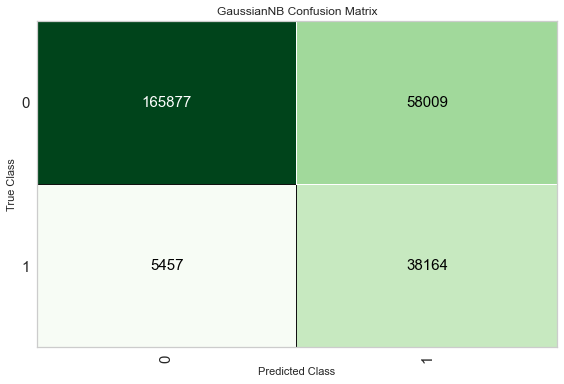

In [27]:
# train confusion matrix
plot_model(best_model, plot='confusion_matrix', use_train_data=True)

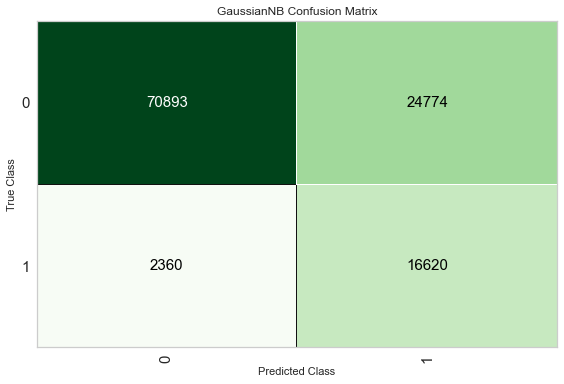

In [29]:
# validation confusion matrix (set aside internally by pycaret's train test 70/30 split)
plot_model(best_model, plot='confusion_matrix')

In [31]:
# load testing data
renew_test_df = pd.read_csv('../data/inputs/test.csv')
print(renew_test_df.shape)
renew_test_df.head()

(78273, 11)


,cust_id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,days_since_insured
0,57782,Female,34,1,39.0,1,1-2 Year,No,764.9,124.0,146
1,286811,Female,55,1,28.0,0,> 2 Years,Yes,751.5,122.0,109
2,117823,Male,39,1,28.0,1,1-2 Year,No,491.6,26.0,63
3,213992,Male,28,1,50.0,1,1-2 Year,No,810.1,8.0,129
4,324756,Female,24,1,10.0,0,< 1 Year,Yes,735.7,152.0,201


In [51]:
# generating predictions for test dataset
test_predictions = predict_model(best_model, data=renew_test_df, raw_score=True)
print(test_predictions.shape)
test_predictions.head()

(78273, 14)


,cust_id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,days_since_insured,Label,Score_0,Score_1
0,57782,Female,34,1,39.0,1,1-2 Year,No,764.9,124.0,146,0,1.000,0.000
1,286811,Female,55,1,28.0,0,> 2 Years,Yes,751.5,122.0,109,1,0.000,1.000
2,117823,Male,39,1,28.0,1,1-2 Year,No,491.6,26.0,63,0,1.000,0.000
3,213992,Male,28,1,50.0,1,1-2 Year,No,810.1,8.0,129,0,1.000,0.000
4,324756,Female,24,1,10.0,0,< 1 Year,Yes,735.7,152.0,201,0,0.929,0.071


In [52]:
# subsetting renewal propensity output in required format
sample_submission = test_predictions[['cust_id','Score_1']]
sample_submission.rename(columns={'Score_1':'propensity'}, inplace=True)
print(sample_submission.shape)
sample_submission.head()

(78273, 2)


,cust_id,propensity
0,57782,0.000
1,286811,1.000
2,117823,0.000
3,213992,0.000
4,324756,0.071


In [53]:
# exporting output for submission
sample_submission.to_csv('../data/outputs/sample_submission.csv')

In [60]:
# assuming a business aligned propensity of 51% and above to trigger renewal group actions/offers,
# while 50% and below to trigger churn group actions/offers
test_predictions['propensity_action'] = test_predictions['Score_1'].apply(lambda x: 'higher propensity to renew' if x>=0.51 else 'higher propensity to churn')
print(test_predictions.shape)
test_predictions.head()

(78273, 15)


,cust_id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,days_since_insured,Label,Score_0,Score_1,propensity_action
0,57782,Female,34,1,39.0,1,1-2 Year,No,764.9,124.0,146,0,1.000,0.000,higher propensity to churn
1,286811,Female,55,1,28.0,0,> 2 Years,Yes,751.5,122.0,109,1,0.000,1.000,higher propensity to renew
2,117823,Male,39,1,28.0,1,1-2 Year,No,491.6,26.0,63,0,1.000,0.000,higher propensity to churn
3,213992,Male,28,1,50.0,1,1-2 Year,No,810.1,8.0,129,0,1.000,0.000,higher propensity to churn
4,324756,Female,24,1,10.0,0,< 1 Year,Yes,735.7,152.0,201,0,0.929,0.071,higher propensity to churn


In [61]:
test_predictions['propensity_action'].value_counts()

higher propensity to churn    50120
higher propensity to renew    28153
Name: propensity_action, dtype: int64

In [62]:
fig = px.pie(test_predictions, values='cust_id', names='propensity_action', width=500, height=400,
             title='Propensity distribution',color_discrete_sequence=px.colors.qualitative.Pastel)
fig.show()

In [65]:
# descriptive insights on the ~64% customers with higher propensity to churn
propensity_churn = test_predictions[test_predictions['propensity_action']=='higher propensity to churn']

# plotting for discrete attributes
cust_profile_cols = ['gender', 'driving_license', 'previously_insured', 'vehicle_age', 'vehicle_damage']

for col in cust_profile_cols:
    propensity_churn_grp = propensity_churn[col].value_counts().reset_index(name='value')
    fig = px.pie(propensity_churn_grp, values='value', names='index', width=500, height=400,
                 title=f'Churn by {col}', color_discrete_sequence=px.colors.qualitative.Pastel)
    fig.show()

In [84]:
# plotting for continuous attributes
cont_profile_cols = ['age', 'region_code', 'annual_premium', 'policy_sales_channel', 'days_since_insured']

for col in cont_profile_cols:
    fig = px.histogram(propensity_churn, x=col, width=900, height=400, 
                       title=f'Churn distribution by {col}', color_discrete_sequence=px.colors.qualitative.Pastel)
    fig.show()

---